In [1]:
import pandas as pd
import numpy as np
from decimal import Decimal
import seaborn as sns
import requests
import folium
import folium.plugins
from folium.plugins import MarkerCluster
import matplotlib as mpl
import matplotlib.pyplot as plt
import json
import geopandas as gpd
import warnings


warnings.filterwarnings('ignore')

plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

pd.options.display.float_format = lambda x: f'{x:.3f}'

print(f'folium: {folium.__version__}')
print(f'requests: {requests.__version__}')
print(f'pandas: {pd.__version__}')
print(f'numpy: {np.__version__}')
print(f'seaborn: {sns.__version__}')
print(f'matplotlib: {mpl.__version__}')

%matplotlib inline

folium: 0.15.0
requests: 2.31.0
pandas: 2.1.3
numpy: 1.26.2
seaborn: 0.13.0
matplotlib: 3.8.2


## 데이터 파일 불러오기 & 구조 확인

In [2]:
airbnb = pd.read_csv('NYC-Airbnb-2023.csv')
airbnb

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.754,-73.986,Entire home/apt,150,30,49,2022-06-21,0.300,3,314,1,NaN
1,5121,BlissArtsSpace!,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.685,-73.955,Private room,60,30,50,2019-12-02,0.300,2,365,0,NaN
2,5203,Cozy Clean Guest Room - Family Apt,7490,MaryEllen,Manhattan,Upper West Side,40.804,-73.968,Private room,75,2,118,2017-07-21,0.720,1,0,0,NaN
3,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Midtown,40.765,-73.983,Private room,68,2,575,2023-02-19,3.410,1,106,52,NaN
4,5136,"Large Sunny Brooklyn Duplex, Patio + Garden",7378,Rebecca,Brooklyn,Sunset Park,40.663,-73.995,Entire home/apt,275,60,3,2022-08-10,0.030,1,181,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42926,839753193689829909,bright studio in Williamsburg,28057253,Jean,Brooklyn,Williamsburg,40.719,-73.964,Entire home/apt,76,7,0,NaN,NaN,1,8,0,NaN
42927,839786573617495393,Room in the heart of LES with Gym& Rooftop BBQ,247439246,Charlene,Manhattan,East Village,40.722,-73.981,Private room,32,30,0,NaN,NaN,5,79,0,NaN
42928,839797749155954018,Fantastic 3BD apt in Brooklyn,26349246,Jose,Brooklyn,Bushwick,40.689,-73.908,Entire home/apt,127,3,0,NaN,NaN,8,356,0,NaN
42929,839814083143454171,The Coziest Home,48533809,Remmy,Staten Island,Bull's Head,40.617,-74.165,Entire home/apt,280,1,0,NaN,NaN,1,87,0,NaN


In [3]:
# 에어비앤비 구조
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42931 entries, 0 to 42930
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              42931 non-null  int64  
 1   name                            42919 non-null  object 
 2   host_id                         42931 non-null  int64  
 3   host_name                       42926 non-null  object 
 4   neighbourhood_group             42931 non-null  object 
 5   neighbourhood                   42931 non-null  object 
 6   latitude                        42931 non-null  float64
 7   longitude                       42931 non-null  float64
 8   room_type                       42931 non-null  object 
 9   price                           42931 non-null  int64  
 10  minimum_nights                  42931 non-null  int64  
 11  number_of_reviews               42931 non-null  int64  
 12  last_review                     

In [4]:
#컬럼명 확인
airbnb.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'number_of_reviews_ltm', 'license'],
      dtype='object')

## 데이터 범위 재설정

전체 데이터를 전처리하기에는 세세하고 많은 과정이 필요해 샘플데이터로 데이터의 리스크가 적은 최소 숙박일 1일 데이터만 전처리.

### 최소 숙박일 1일 데이터 추출 및 저장

In [5]:
airbnb_1day = airbnb[airbnb['minimum_nights'] == 1]

In [6]:
airbnb_1day.sort_values(by=['room_type']).to_csv('airbnb_1day.csv', index=False)
airbnb_1day = pd.read_csv('airbnb_1day.csv')

In [7]:
# 최소숙박일수 1일 가격 기본통계량
airbnb_1day['price'].describe()

count    7946.000
mean      276.050
std      1798.702
min         0.000
25%        80.000
50%       130.500
75%       239.000
max     99000.000
Name: price, dtype: float64

## airbnb_1day 데이터 전처리

### 안쓰는 컬럼 삭제

In [8]:
del_cols = ['id', 'host_name', 'number_of_reviews', 'last_review', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365', 'number_of_reviews_ltm', 'license']
airbnb_1day.drop(del_cols, axis = 1, inplace=True)

### neighbourhood_group 컬럼명 변경

In [9]:
airbnb_1day.rename(columns = {'neighbourhood_group': 'borough'}, inplace=True)

In [10]:
airbnb_1day.columns

Index(['name', 'host_id', 'borough', 'neighbourhood', 'latitude', 'longitude',
       'room_type', 'price', 'minimum_nights'],
      dtype='object')

### Null값 확인

In [11]:
airbnb_1day.isna().sum()

name              0
host_id           0
borough           0
neighbourhood     0
latitude          0
longitude         0
room_type         0
price             0
minimum_nights    0
dtype: int64

### 경도,위도 타입 변경

In [12]:
airbnb_1day[['latitude', 'longitude']] = airbnb_1day[['latitude', 'longitude']].applymap(Decimal).astype(np.dtype(Decimal))

In [13]:
airbnb_1day

,name,host_id,borough,neighbourhood,latitude,longitude,room_type,price,minimum_nights
0,Lovely 2 bedroom w/ jacuzzi tub. 5mins from JFK,445742022,Queens,Jamaica,40.6753000000000000113686837721616029739379882...,-73.795379999999994424797478131949901580810546875,Entire home/apt,137,1
1,My heart belongs in Brooklyn cozy home,450443676,Brooklyn,Bedford-Stuyvesant,40.6863200000000020395418687257915735244750976...,-73.923019999999993956407706718891859054565429...,Entire home/apt,200,1
2,Luxury Apt in NYC/NJ | Free Parking | Near Train,458447508,Staten Island,Prince's Bay,40.524979999999999336068867705762386322021484375,-74.215140000000005215952114667743444442749023...,Entire home/apt,171,1
3,Apartamento completo cómodo y moderno,150551412,Queens,Howard Beach,40.6616591020478708173868653830140829086303710...,-73.83774665991091978867189027369022369384765625,Entire home/apt,108,1
4,Spacious Apt in Historic Brooklyn Neighborhood,68296703,Brooklyn,Crown Heights,40.6737299999999990518517734017223119735717773...,-73.927250000000000795807864051312208175659179...,Entire home/apt,104,1
...,...,...,...,...,...,...,...,...,...
7941,Lovely two bedroom apartments,466889396,Brooklyn,East New York,40.6608949000000023943357518874108791351318359375,-73.887238799999991556433087680488824844360351...,Shared room,247,1
7942,Lovely room,24146326,Queens,Astoria,40.7664199999999965484676067717373371124267578125,-73.93000000000000682121026329696178436279296875,Shared room,560,1
7943,Comfy room,24146326,Queens,Astoria,40.766379999999998062776285223662853240966796875,-73.931259999999994647623680066317319869995117...,Shared room,480,1
7944,Cozy & Relax LLC,92610445,Brooklyn,East New York,40.66852000000000089130480773746967315673828125,-73.874759999999994874997355509549379348754882...,Shared room,90,1


### 가격 = 0 인 숙소 제거

In [14]:
#기초통계량으로 최솟값 확인
airbnb_1day['price'].describe()

count    7946.000
mean      276.050
std      1798.702
min         0.000
25%        80.000
50%       130.500
75%       239.000
max     99000.000
Name: price, dtype: float64

In [15]:
# 가격 = 0인 숙소 조회
airbnb_1day[airbnb_1day['price'] == 0]

,name,host_id,borough,neighbourhood,latitude,longitude,room_type,price,minimum_nights
3292,Equinox Hotel New York,375044940,Manhattan,Chelsea,40.7553224600003645150536613073199987411499023...,-74.00177192695872463445994071662425994873046875,Hotel room,0,1
3327,The William Vale,373522899,Brooklyn,Williamsburg,40.7212102811540930247247160878032445907592773...,-73.957208952958040981684462167322635650634765625,Hotel room,0,1
3330,HGU New York,390810530,Manhattan,Midtown,40.746835798452281096615479327738285064697265625,-73.982699330837050410991651006042957305908203125,Hotel room,0,1
3333,CITIZENM NEW YORK TIMES SQUARE HOTEL,373324108,Manhattan,Theater District,40.7623680276793578514116234146058559417724609375,-73.985675763081218292427365668118000030517578125,Hotel room,0,1
3353,"The Standard, East Village",360662584,Manhattan,East Village,40.727429999999998244675225578248500823974609375,-73.991360000000000241016095969825983047485351...,Hotel room,0,1
3366,citizenM New York Bowery hotel,374516933,Manhattan,Lower East Side,40.7197323458619067082508991006761789321899414...,-73.993995677456084081313747446984052658081054...,Hotel room,0,1
3371,The James New York - NoMad,268417148,Manhattan,Midtown,40.7445900000000023055690689943730831146240234375,-73.985740000000006943992048036307096481323242...,Hotel room,0,1
3373,Wellington Hotel,335389657,Manhattan,Midtown,40.7644799999999989381649356801062822341918945...,-73.980549999999993815436027944087982177734375,Hotel room,0,1
3377,SIXTY LES,342053968,Manhattan,Lower East Side,40.7221400000000031127456168178468942642211914...,-73.988569999999995729922375176101922988891601...,Hotel room,0,1
3383,"The Hoxton, Williamsburg - Cosy Room",273324213,Brooklyn,Williamsburg,40.7209599999999980468601279426366090774536132...,-73.958600000000004115463525522500276565551757...,Hotel room,0,1


In [16]:
#값이 0인 숙소 수 = 19개
(airbnb_1day['price'] == 0).sum()

19

In [17]:
#가격이 0인 데이터는 변별력에 의미가 없어 제거. 전체 데이터의 0.23%
airbnb_1day = airbnb_1day[airbnb_1day['price'] != 0]

### 가격 이상치 확인

In [18]:
airbnb_1day['price'].describe()

count    7927.000
mean      276.712
std      1800.806
min        19.000
25%        80.000
50%       131.000
75%       239.000
max     99000.000
Name: price, dtype: float64

#### 룸타입별 기본통계량, Q1, Q3, IQR, ufence, lfence 구하기

In [19]:
# 최소숙박일수 1일 룸타입별 기본통계량
room_price_des = airbnb_1day.groupby('room_type')['price']
room_price_des.describe()

,count,mean,std,min,25%,50%,75%,max
room_type,,,,,,,,
Entire home/apt,3267.000,344.818,1795.325,35.000,125.000,185.000,295.000,99000.000
Hotel room,133.000,334.233,230.273,140.000,220.000,259.000,350.000,1592.000
Private room,4359.000,230.071,1863.408,19.000,65.000,91.000,179.000,85170.000
Shared room,168.000,116.899,214.742,20.000,34.750,51.000,96.250,1560.000


In [20]:
for room_type, prices in room_price_des:
    Q1 = prices.quantile(0.25)
    Q3 = prices.quantile(0.75)
    IQR = Q3 - Q1
    ufence = Q3 + 1.5 * IQR
    lfence = Q1 - 1.5 * IQR

    print(f"Room Type: {room_type}",
    f"Q1: {Q1}",
    f"Q3: {Q3}",
    f"IQR: {IQR}",
    f"ufence: {ufence}",
    f"lfence: {lfence}\n")

Room Type: Entire home/apt Q1: 125.0 Q3: 295.0 IQR: 170.0 ufence: 550.0 lfence: -130.0

Room Type: Hotel room Q1: 220.0 Q3: 350.0 IQR: 130.0 ufence: 545.0 lfence: 25.0

Room Type: Private room Q1: 65.0 Q3: 179.0 IQR: 114.0 ufence: 350.0 lfence: -106.0

Room Type: Shared room Q1: 34.75 Q3: 96.25 IQR: 61.5 ufence: 188.5 lfence: -57.5



### 6000달러 이상의 이상치 제거

6000달러는 한화 기준 약 780만원 이상의 값으로 에어비앤비 이용자의 하루 숙박비용의 평균을 내는 데에는 적합하지 않다고 판단해 6000달러 이상의 이상치는 제거한다.
데이터의 0.12%

<Axes: xlabel='room_type', ylabel='price'>

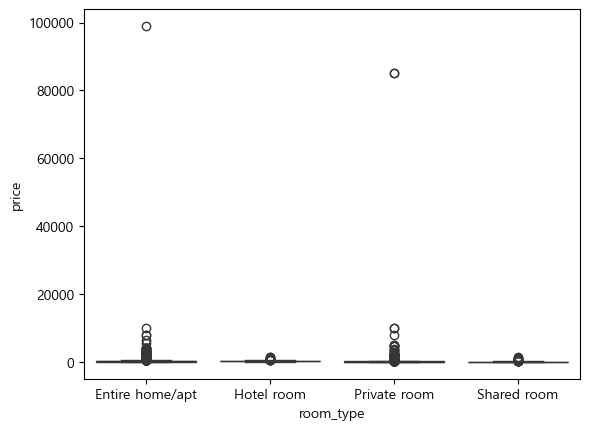

In [21]:
sns.boxplot(x='room_type', y='price', data=airbnb_1day, palette='Dark2', hue='room_type', legend=False)

In [22]:
#6000달러 이상의 이상치 조회 -10개
airbnb_1day[airbnb_1day['price'] >= 6000]

,name,host_id,borough,neighbourhood,latitude,longitude,room_type,price,minimum_nights
362,46th Floor Private Rooftop,472600679,Brooklyn,Williamsburg,40.7157800000000023032953322399407625198364257...,-73.966570000000004370122042018920183181762695...,Entire home/apt,99000,1
1527,Apartamento único para parejas,495524934,Manhattan,SoHo,40.7247115636921890313715266529470682144165039...,-73.99639070034027099609375,Entire home/apt,6500,1
1822,"Eighth House, State of the Art NYC Venue",76166434,Manhattan,Midtown,40.764693748527605521303485147655010223388671875,-73.982688378134739082270243670791387557983398...,Entire home/apt,8000,1
1838,The Vantage Point @ Eighth House,76166434,Manhattan,Midtown,40.7655400000000014415491023100912570953369140625,-73.982929999999996084625308867543935775756835...,Entire home/apt,8000,1
1970,historical Gothic castle design for the apartment,366397761,Queens,Bellerose,40.7256526999999977078914525918662548065185546875,-73.72160239999999475912773050367832183837890625,Entire home/apt,9999,1
5695,Esmeralda Room,417186426,Queens,South Ozone Park,40.6736000000000004206412995699793100357055664...,-73.815039999999996211954567115753889083862304...,Private room,8085,1
6294,WELCOME HOME 15 MINUTES TO MANHATTAN BOOK TODAY,76699286,Bronx,Longwood,40.8245599999999981832843332085758447647094726...,-73.888189999999994483914633747190237045288085...,Private room,9994,1
7121,"Artsy, Trendy, Warm, Home - Extra!",18586628,Manhattan,East Harlem,40.8119799999999983697307470720261335372924804...,-73.93596999999999752617441117763519287109375,Private room,85100,1
7657,"The Allen Hotel, Deluxe Penthouse King Suite",266741420,Manhattan,Lower East Side,40.7191800000000014847501006443053483963012695...,-73.991230000000001609805622138082981109619140625,Private room,10000,1
7737,Groovy bedroom in BK next to METRO & Industry ...,51913277,Brooklyn,Sunset Park,40.6553499999999985448084771633148193359375,-74.002979999999993765413819346576929092407226...,Private room,85170,1


In [23]:
# 6000달러 이상치 제거 - 남은데이터 총 7917개
airbnb_1day = airbnb_1day[airbnb_1day['price'] < 6000]
airbnb_1day

,name,host_id,borough,neighbourhood,latitude,longitude,room_type,price,minimum_nights
0,Lovely 2 bedroom w/ jacuzzi tub. 5mins from JFK,445742022,Queens,Jamaica,40.6753000000000000113686837721616029739379882...,-73.795379999999994424797478131949901580810546875,Entire home/apt,137,1
1,My heart belongs in Brooklyn cozy home,450443676,Brooklyn,Bedford-Stuyvesant,40.6863200000000020395418687257915735244750976...,-73.923019999999993956407706718891859054565429...,Entire home/apt,200,1
2,Luxury Apt in NYC/NJ | Free Parking | Near Train,458447508,Staten Island,Prince's Bay,40.524979999999999336068867705762386322021484375,-74.215140000000005215952114667743444442749023...,Entire home/apt,171,1
3,Apartamento completo cómodo y moderno,150551412,Queens,Howard Beach,40.6616591020478708173868653830140829086303710...,-73.83774665991091978867189027369022369384765625,Entire home/apt,108,1
4,Spacious Apt in Historic Brooklyn Neighborhood,68296703,Brooklyn,Crown Heights,40.6737299999999990518517734017223119735717773...,-73.927250000000000795807864051312208175659179...,Entire home/apt,104,1
...,...,...,...,...,...,...,...,...,...
7941,Lovely two bedroom apartments,466889396,Brooklyn,East New York,40.6608949000000023943357518874108791351318359375,-73.887238799999991556433087680488824844360351...,Shared room,247,1
7942,Lovely room,24146326,Queens,Astoria,40.7664199999999965484676067717373371124267578125,-73.93000000000000682121026329696178436279296875,Shared room,560,1
7943,Comfy room,24146326,Queens,Astoria,40.766379999999998062776285223662853240966796875,-73.931259999999994647623680066317319869995117...,Shared room,480,1
7944,Cozy & Relax LLC,92610445,Brooklyn,East New York,40.66852000000000089130480773746967315673828125,-73.874759999999994874997355509549379348754882...,Shared room,90,1


In [24]:
# 최소숙박일수 1일 룸타입별 기본통계량확인
room_price_des = airbnb_1day.groupby('room_type')['price']
room_price_des.describe()

,count,mean,std,min,25%,50%,75%,max
room_type,,,,,,,,
Entire home/apt,3262.000,305.035,407.172,35.000,125.000,185.000,294.750,5500.000
Hotel room,133.000,334.233,230.273,140.000,220.000,259.000,350.000,1592.000
Private room,4354.000,184.780,322.635,19.000,65.000,91.000,178.750,5143.000
Shared room,168.000,116.899,214.742,20.000,34.750,51.000,96.250,1560.000


In [25]:
for room_type, prices in room_price_des:
    Q1 = prices.quantile(0.25)
    Q3 = prices.quantile(0.75)
    IQR = Q3 - Q1
    ufence = Q3 + 1.5 * IQR
    lfence = Q1 - 1.5 * IQR

    print(f"Room Type: {room_type}",
    f"Q1: {Q1}",
    f"Q3: {Q3}",
    f"IQR: {IQR}",
    f"ufence: {ufence}",
    f"lfence: {lfence}\n")

Room Type: Entire home/apt Q1: 125.0 Q3: 294.75 IQR: 169.75 ufence: 549.375 lfence: -129.625

Room Type: Hotel room Q1: 220.0 Q3: 350.0 IQR: 130.0 ufence: 545.0 lfence: 25.0

Room Type: Private room Q1: 65.0 Q3: 178.75 IQR: 113.75 ufence: 349.375 lfence: -105.625

Room Type: Shared room Q1: 34.75 Q3: 96.25 IQR: 61.5 ufence: 188.5 lfence: -57.5



### 자치구 중 Staten Island 이상치 제거

'neighbourhood_group'의 Staten Island의 상자그림을 살펴보니 다른 값과 동떨어진 값 1개를 발견.  
지역별 평균값에 영향을 끼치기 때문에 제거하기로 결정

In [26]:
# 최소숙박일수 1일 자치구별 기본통계량확인
room_price_des = airbnb_1day.groupby('borough')['price']
room_price_des.describe()

,count,mean,std,min,25%,50%,75%,max
borough,,,,,,,,
Bronx,535.000,114.426,119.396,20.000,56.000,85.000,136.000,2000.000
Brooklyn,2291.000,171.792,269.387,28.000,74.000,111.000,179.000,5500.000
Manhattan,3052.000,375.812,480.418,29.000,135.000,226.500,380.250,5000.000
Queens,1936.000,125.364,132.201,19.000,65.000,91.000,140.000,2200.000
Staten Island,103.000,186.117,508.161,40.000,80.000,101.000,144.000,5143.000


<Axes: xlabel='borough', ylabel='price'>

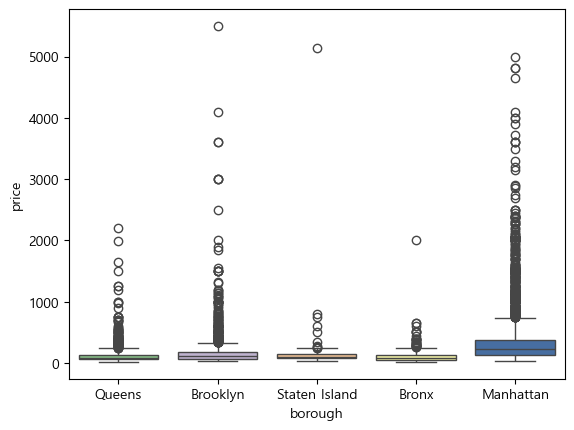

In [27]:
sns.boxplot(x='borough', y='price', data=airbnb_1day, palette='Accent', hue='borough', legend=False)

In [28]:
#자치구(Staten Island) 중 5000달러 이상의 이상치 조회 - 1개
airbnb_1day[(airbnb_1day['borough'] == 'Staten Island') & (airbnb_1day['price'] >= 5000)]

,name,host_id,borough,neighbourhood,latitude,longitude,room_type,price,minimum_nights
5164,Small room in Historical home on Staten Island,128338539,Staten Island,Stapleton,40.630189999999998917701304890215396881103515625,-74.080740000000005807123670820146799087524414...,Private room,5143,1


In [29]:
#자치구(Staten Island) 중 5000달러 이상의 이상치 제거 - 총 103개 데이터 중 1개 삭제 = 102개 데이터
out_5000 = (airbnb_1day['borough'] == 'Staten Island') & (airbnb_1day['price'] >= 5000)
airbnb_1day = airbnb_1day[~out_5000]
airbnb_1day

,name,host_id,borough,neighbourhood,latitude,longitude,room_type,price,minimum_nights
0,Lovely 2 bedroom w/ jacuzzi tub. 5mins from JFK,445742022,Queens,Jamaica,40.6753000000000000113686837721616029739379882...,-73.795379999999994424797478131949901580810546875,Entire home/apt,137,1
1,My heart belongs in Brooklyn cozy home,450443676,Brooklyn,Bedford-Stuyvesant,40.6863200000000020395418687257915735244750976...,-73.923019999999993956407706718891859054565429...,Entire home/apt,200,1
2,Luxury Apt in NYC/NJ | Free Parking | Near Train,458447508,Staten Island,Prince's Bay,40.524979999999999336068867705762386322021484375,-74.215140000000005215952114667743444442749023...,Entire home/apt,171,1
3,Apartamento completo cómodo y moderno,150551412,Queens,Howard Beach,40.6616591020478708173868653830140829086303710...,-73.83774665991091978867189027369022369384765625,Entire home/apt,108,1
4,Spacious Apt in Historic Brooklyn Neighborhood,68296703,Brooklyn,Crown Heights,40.6737299999999990518517734017223119735717773...,-73.927250000000000795807864051312208175659179...,Entire home/apt,104,1
...,...,...,...,...,...,...,...,...,...
7941,Lovely two bedroom apartments,466889396,Brooklyn,East New York,40.6608949000000023943357518874108791351318359375,-73.887238799999991556433087680488824844360351...,Shared room,247,1
7942,Lovely room,24146326,Queens,Astoria,40.7664199999999965484676067717373371124267578125,-73.93000000000000682121026329696178436279296875,Shared room,560,1
7943,Comfy room,24146326,Queens,Astoria,40.766379999999998062776285223662853240966796875,-73.931259999999994647623680066317319869995117...,Shared room,480,1
7944,Cozy & Relax LLC,92610445,Brooklyn,East New York,40.66852000000000089130480773746967315673828125,-73.874759999999994874997355509549379348754882...,Shared room,90,1


### airbnb_1day.csv 저장

In [30]:
airbnb_1day.sort_values(by=['room_type']).to_csv('airbnb_1day.csv', index=False)
airbnb_1day = pd.read_csv('airbnb_1day.csv')

## 탐색적 데이터 분석(EDA)

In [31]:
airbnb_1day.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7916 entries, 0 to 7915
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   name            7916 non-null   object 
 1   host_id         7916 non-null   int64  
 2   borough         7916 non-null   object 
 3   neighbourhood   7916 non-null   object 
 4   latitude        7916 non-null   float64
 5   longitude       7916 non-null   float64
 6   room_type       7916 non-null   object 
 7   price           7916 non-null   int64  
 8   minimum_nights  7916 non-null   int64  
dtypes: float64(2), int64(3), object(4)
memory usage: 556.7+ KB


In [32]:
# 최소숙박일수 1일 neighbourhood별 기본통계량확인
room_price_des = airbnb_1day.groupby('neighbourhood')['price']
room_price_des.describe()

,count,mean,std,min,25%,50%,75%,max
neighbourhood,,,,,,,,
Allerton,16.000,153.688,151.057,36.000,69.500,92.000,137.250,500.000
Arden Heights,1.000,83.000,NaN,83.000,83.000,83.000,83.000,83.000
Arrochar,4.000,125.250,26.961,105.000,112.500,115.500,128.250,165.000
Arverne,20.000,153.750,106.452,59.000,77.000,129.500,186.750,536.000
Astoria,159.000,107.107,87.448,37.000,60.000,75.000,122.000,671.000
...,...,...,...,...,...,...,...,...
Windsor Terrace,17.000,139.353,66.310,67.000,94.000,113.000,175.000,271.000
Woodhaven,21.000,82.333,72.108,36.000,45.000,65.000,80.000,363.000
Woodlawn,6.000,157.667,139.022,43.000,56.500,107.500,214.000,399.000


In [33]:
# 네이버후드 개수
airbnb_1day['neighbourhood'].nunique()

208

### 시각화

#### 가격 상자그림그래프

<Axes: xlabel='room_type', ylabel='price'>

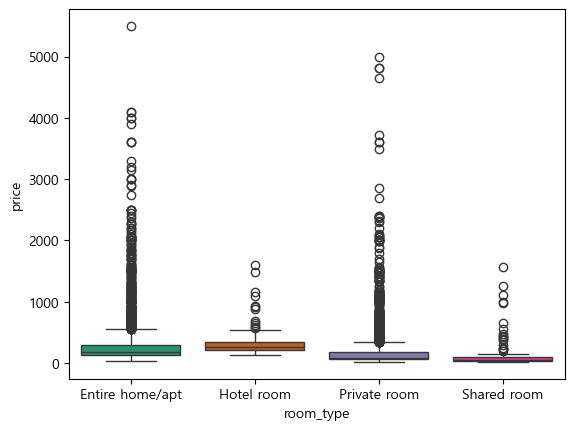

In [34]:
sns.boxplot(x='room_type', y='price', data=airbnb_1day, palette='Dark2', hue='room_type', legend=False)

<Axes: xlabel='borough', ylabel='price'>

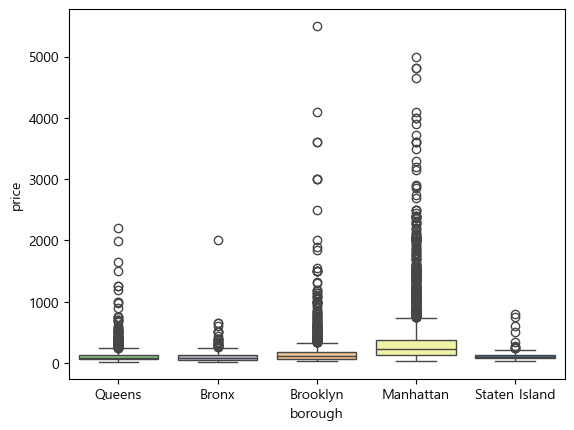

In [35]:
sns.boxplot(x='borough', y='price', data=airbnb_1day, palette='Accent', hue='borough', legend=False)

뉴욕시에는 다양한 유형과 가격의 숙소가 존재하기 때문에 상자그림 내의 가격범위로만 평균을 잡기에는 맞지않다는 판단이 들었고,  
이상치 중에서도 초고가의 가격대를 지닌 데이터는 삭제 처리 후 남은 데이터들로 진행한다.

#### 막대그래프( neighbourhood_group & room_type 별 count graph)

In [36]:
room_count = airbnb_1day['room_type'].value_counts()
room_count

room_type
Private room       4353
Entire home/apt    3262
Shared room         168
Hotel room          133
Name: count, dtype: int64

In [37]:
borough_count = airbnb_1day['borough'].value_counts()
borough_count

borough
Manhattan        3052
Brooklyn         2291
Queens           1936
Bronx             535
Staten Island     102
Name: count, dtype: int64

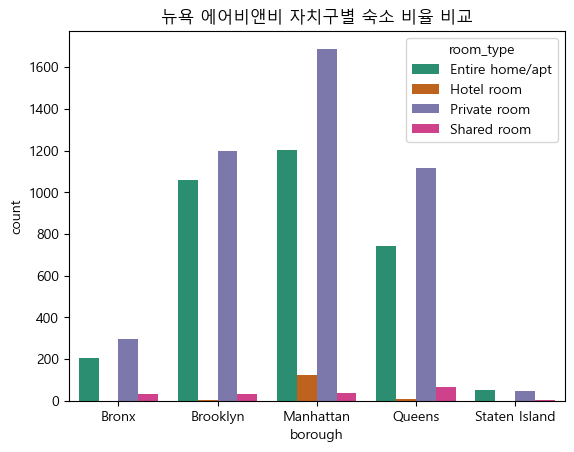

In [38]:
# 지역별 room type 숙소 카운트개수
neighb_room_value = airbnb_1day.groupby(['room_type', 'borough']).size().reset_index(name='count')

ax = sns.barplot(x='borough', y='count', hue='room_type', data=neighb_room_value, palette='Dark2')
plt.title('뉴욕 에어비앤비 자치구별 숙소 비율 비교')
plt.show()

In [39]:
neiborhdgrp_count = airbnb_1day['borough'].value_counts()
neiborhdgrp_count

borough
Manhattan        3052
Brooklyn         2291
Queens           1936
Bronx             535
Staten Island     102
Name: count, dtype: int64

#### 자치구 당 neighbourhood별 평균가격 비교그래프

자치구 당 neighbourhood별 평균가격 조회

In [40]:
boroughBronx = airbnb_1day[airbnb_1day['borough'] == 'Bronx'].groupby('neighbourhood')['price'].mean().reset_index()
boroughBronx_sorted = boroughBronx.sort_values(by='price', ascending=False)
boroughBronx_sorted

,neighbourhood,price
6,Claremont Village,238.500
35,Schuylerville,199.421
7,Clason Point,163.833
29,Olinville,158.333
46,Woodlawn,157.667
0,Allerton,153.688
24,Mott Haven,134.540
41,Van Nest,133.857
3,Bronxdale,133.000
39,Unionport,131.167


In [41]:
boroughManhattan = airbnb_1day[airbnb_1day['borough'] == 'Manhattan'].groupby('neighbourhood')['price'].mean().reset_index()
boroughManhattan_sorted = boroughManhattan.sort_values(by='price', ascending=False)
boroughManhattan_sorted

,neighbourhood,price
24,Stuyvesant Town,1250.000
23,SoHo,867.858
7,Flatiron District,735.867
31,West Village,651.143
19,Murray Hill,586.480
25,Theater District,511.836
17,Midtown,488.206
26,Tribeca,467.571
15,Lower East Side,464.090
2,Chinatown,421.500


In [42]:
boroughQueens = airbnb_1day[airbnb_1day['borough'] == 'Queens'].groupby('neighbourhood')['price'].mean().reset_index()
boroughQueens_sorted = boroughQueens.sort_values(by='price', ascending=False)
boroughQueens_sorted

,neighbourhood,price
23,Holliswood,543.000
5,Belle Harbor,374.750
27,Jamaica Estates,352.900
41,Rockaway Beach,282.500
32,Little Neck,225.000
24,Howard Beach,216.824
19,Forest Hills,202.139
30,Kew Gardens Hills,200.750
15,Edgemere,197.300
6,Bellerose,192.000


In [43]:
boroughBrooklyn = airbnb_1day[airbnb_1day['borough'] == 'Brooklyn'].groupby('neighbourhood')['price'].mean().reset_index()
boroughBrooklyn_sorted = boroughBrooklyn.sort_values(by='price', ascending=False)
boroughBrooklyn_sorted

,neighbourhood,price
35,Navy Yard,1550.000
4,Bergen Beach,841.750
39,Red Hook,592.833
32,Manhattan Beach,489.500
19,Downtown Brooklyn,457.600
37,Prospect Heights,332.958
30,Greenpoint,307.455
28,Gowanus,283.647
5,Boerum Hill,273.778
36,Park Slope,254.690


In [44]:
boroughSland = airbnb_1day[airbnb_1day['borough'] == 'Staten Island'].groupby('neighbourhood')['price'].mean().reset_index()
boroughSland_sorted = boroughBrooklyn.sort_values(by='price', ascending=False)
boroughSland_sorted

,neighbourhood,price
35,Navy Yard,1550.000
4,Bergen Beach,841.750
39,Red Hook,592.833
32,Manhattan Beach,489.500
19,Downtown Brooklyn,457.600
37,Prospect Heights,332.958
30,Greenpoint,307.455
28,Gowanus,283.647
5,Boerum Hill,273.778
36,Park Slope,254.690


자치구 당 neighbourhood별 평균가격 비교 패싯그리드 막대그래프

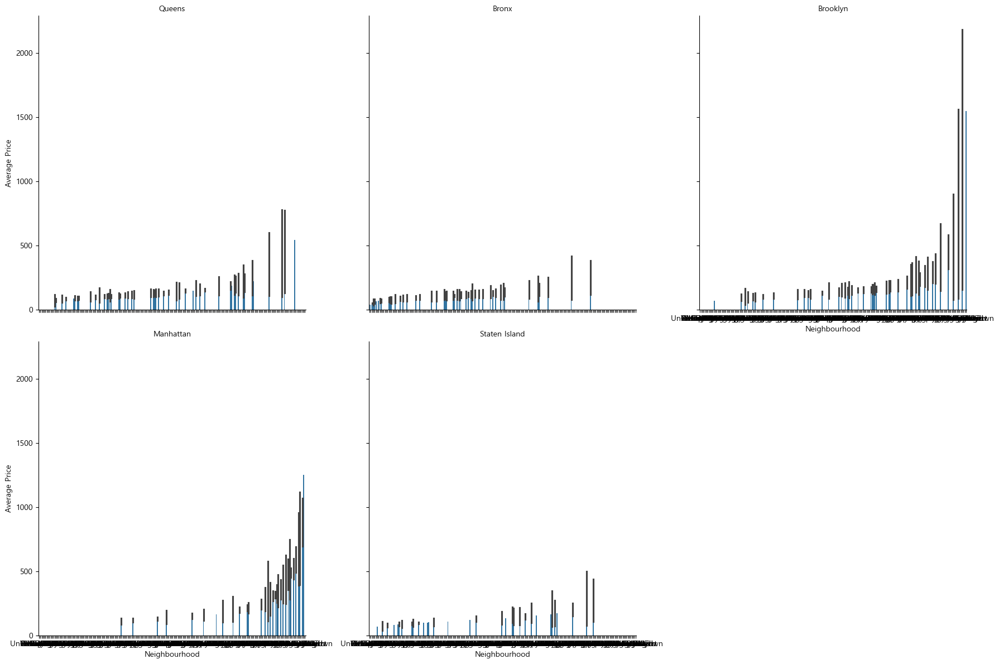

In [45]:
g = sns.FacetGrid(airbnb_1day, col='borough', col_wrap=3, height=6)
g.map(sns.barplot, 'neighbourhood', 'price', order=airbnb_1day.groupby('neighbourhood')['price'].mean().sort_values().index)
g.set_axis_labels('Neighbourhood', 'Average Price')
g.set_titles(col_template='{col_name}')
plt.show()

### 뉴욕시 에어비앤비 지도 시각화

#### 숙소 위치와 분포 지도 시각화

In [46]:
# 경계 데이터 경로
neighbourhood_boundaries_geojson = "2010 Neighborhood Tabulation Areas (NTAs).geojson"
geojson_path = "Borough Boundaries.geojson"
airbnb_1day = pd.read_csv("airbnb_1day.csv")

# 자치구 경계 GeoDataFrame 생성
borough_geo = gpd.read_file(geojson_path)

# 자치구 경계 지도 생성
borough_map = folium.Map(location=[40.7128, -74.0060], zoom_start=10)

# MarkerCluster 객체 생성
marker_cluster = MarkerCluster(name='MarkerCluster').add_to(borough_map)

# airbnb_1day 데이터를 Marker로 지도에 추가
for index, row in airbnb_1day.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        icon=None,  # 기본 아이콘 사용
        popup=f"${row['price']}",
    ).add_to(marker_cluster)
    
# 'neighbourhood' 경계 GeoJSON 추가
neighbourhood_geojson = folium.GeoJson(neighbourhood_boundaries_geojson, name='Neighbourhood Boundaries').add_to(borough_map)

# 자치구 경계 GeoJSON 추가
folium.GeoJson(borough_geo, name='Borough').add_to(borough_map)

# 레이어 컨트롤 추가
folium.LayerControl(collapsed=False).add_to(borough_map)

borough_map

#### Neighborhood별 평균 숙소값 조회

In [47]:
# GeoJSON 파일 경로
neighbourhood_boundaries_geojson = "2010 Neighborhood Tabulation Areas (NTAs).geojson"
borough_geojson = "Borough Boundaries.geojson"
airbnb_1day = pd.read_csv("airbnb_1day.csv")

# 'neighbourhood'별 평균가격 계산
neighbourhood_avg_price = airbnb_1day.groupby('neighbourhood')['price'].mean().reset_index()
# 'neighbourhood'별 평균 위도와 경도 계산
neighbourhood_avg_location = airbnb_1day.groupby('neighbourhood')[['latitude', 'longitude']].mean().reset_index()

# 자치구 경계 GeoDataFrame 생성
borough_geo = gpd.read_file(borough_geojson)

# 자치구 경계 지도 생성
borough_map = folium.Map(location=[40.7128, -74.0060], zoom_start=10)

# 'neighbourhood'별 평균가격을 지도에 추가
for index, row in neighbourhood_avg_price.iterrows():
    neighbourhood_location = neighbourhood_avg_location[neighbourhood_avg_location['neighbourhood'] == row['neighbourhood']]
    if not neighbourhood_location.empty:
        folium.Marker(
            location=[neighbourhood_location.iloc[0]['latitude'], neighbourhood_location.iloc[0]['longitude']],
            icon=None,
            popup=f"neighbourhood: {row['neighbourhood']}\n평균값: ${row['price']:.2f}",
            tooltip="info를 클릭하세요.",
        ).add_to(borough_map)

# 'neighbourhood' 경계 GeoJSON 추가
neighbourhood_geojson = folium.GeoJson(neighbourhood_boundaries_geojson, name='Neighbourhood Boundaries').add_to(borough_map)

# 자치구 경계 GeoJSON 추가
folium.GeoJson(borough_geo, name='Borough').add_to(borough_map)

# LayerControl
folium.LayerControl(collapsed=False).add_to(borough_map)

borough_map